In [2]:
# Import library yang kalian butuhkan
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import cv2 as cv
import os #Digunakan untuk mengelola file dan direktori

## Data Loading

In [3]:
def MuatGambar(folder, jum_gambar_max, target_size=(150, 150)):
    saveGambar = []
    filenames = []
    labelGambar = []

    for label in os.listdir(folder):
        # labelGambar.append(label)
        print(label)
        img_count = 0
        for filename in os.listdir(os.path.join(folder, label)):
            if img_count >= jum_gambar_max:
                break
            img_path = os.path.join(folder, label, filename)
            img = cv.imread(img_path)
            if img is not None:
                img = cv.resize(img, target_size)
                saveGambar.append(img)
                filenames.append(filename)
                labelGambar.append(label)
                img_count += 1
                # print(f"Loaded image {filename} from {label}")
                # print(f"Image {filename} from {label} resized to: {img.shape}")
    return saveGambar, filenames, labelGambar

In [4]:
DataGambar, namaFiles, labelGambar = MuatGambar("FS_Dataset_2024/", 100)

finger_1
finger_2
finger_3
finger_4
finger_5


In [5]:
for i, (img,label) in enumerate(zip(DataGambar, labelGambar)):
    print(f"Image {i} size: {img.shape}, Label: {label}")

Image 0 size: (150, 150, 3), Label: finger_1
Image 1 size: (150, 150, 3), Label: finger_1
Image 2 size: (150, 150, 3), Label: finger_1
Image 3 size: (150, 150, 3), Label: finger_1
Image 4 size: (150, 150, 3), Label: finger_1
Image 5 size: (150, 150, 3), Label: finger_1
Image 6 size: (150, 150, 3), Label: finger_1
Image 7 size: (150, 150, 3), Label: finger_1
Image 8 size: (150, 150, 3), Label: finger_1
Image 9 size: (150, 150, 3), Label: finger_1
Image 10 size: (150, 150, 3), Label: finger_1
Image 11 size: (150, 150, 3), Label: finger_1
Image 12 size: (150, 150, 3), Label: finger_1
Image 13 size: (150, 150, 3), Label: finger_1
Image 14 size: (150, 150, 3), Label: finger_1
Image 15 size: (150, 150, 3), Label: finger_1
Image 16 size: (150, 150, 3), Label: finger_1
Image 17 size: (150, 150, 3), Label: finger_1
Image 18 size: (150, 150, 3), Label: finger_1
Image 19 size: (150, 150, 3), Label: finger_1
Image 20 size: (150, 150, 3), Label: finger_1
Image 21 size: (150, 150, 3), Label: finger_

In [6]:
label_counts = pd.Series(labelGambar).value_counts()
print("Jumlah data untuk setiap label:")
print(label_counts)

total_data = label_counts.sum()
print(f"Jumlah keseluruhan data: {total_data}")

Jumlah data untuk setiap label:
finger_1    100
finger_2    100
finger_3    100
finger_4    100
finger_5    100
Name: count, dtype: int64
Jumlah keseluruhan data: 500


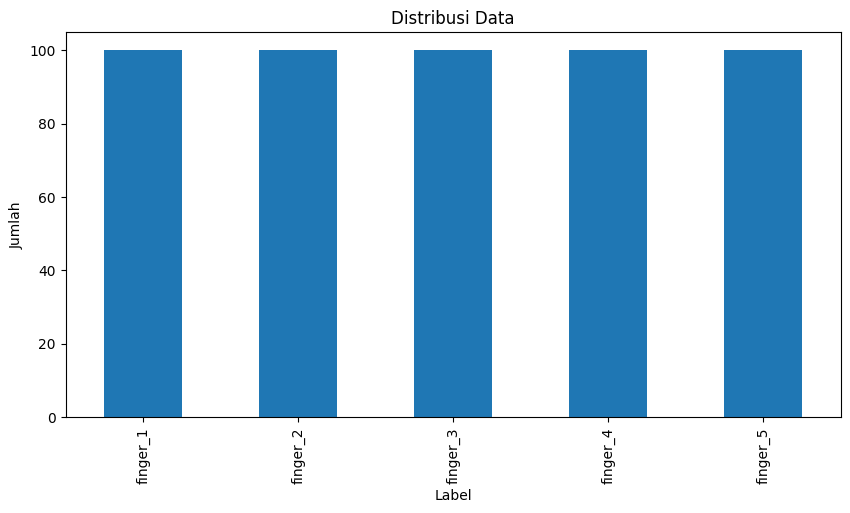

In [7]:
plt.figure(figsize=(10, 5))
label_counts.plot(kind='bar')
plt.title("Distribusi Data")
plt.xlabel("Label")
plt.ylabel("Jumlah")
plt.show()

In [8]:
def plot_sample_images(images, labels, label_names, samples_per_label=10):
    plt.figure(figsize=(30, 30))
    for i, label in enumerate(label_names):
        label_images = [img for img, lbl in zip(images, labels) if lbl == label]
        for j in range(samples_per_label):
            plt.subplot(len(label_names), samples_per_label, i * samples_per_label + j + 1)
            plt.imshow(cv.cvtColor(label_images[j], cv.COLOR_BGR2RGB))
            plt.title(f"Label: {label}")
            plt.axis('off')
    plt.show()

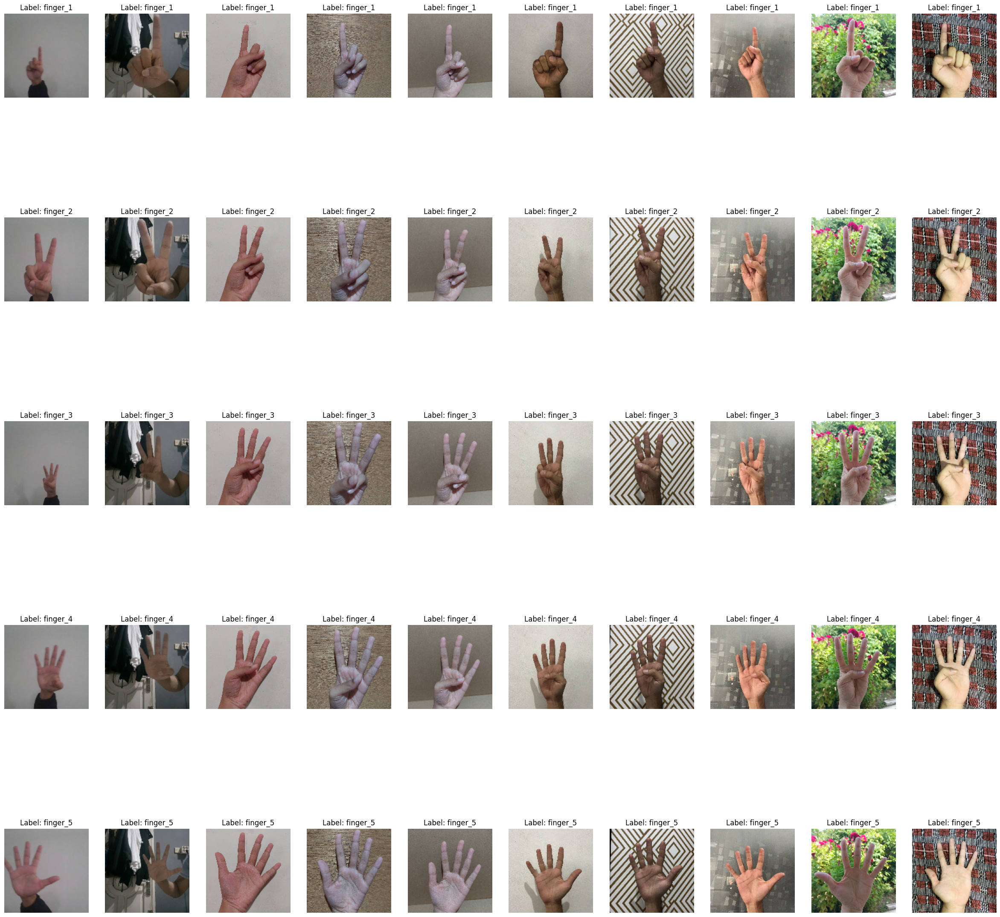

In [9]:
label_names = label_counts.index.tolist()
plot_sample_images(DataGambar, labelGambar, label_names)

In [10]:
def analyze_image_characteristics(images):
    brightness = []
    contrast = []
    
    for img in images:
        gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
        brightness.append(np.mean(gray))
        contrast.append(np.std(gray))
    
    return brightness, contrast

In [11]:
brightness, contrast = analyze_image_characteristics(DataGambar)

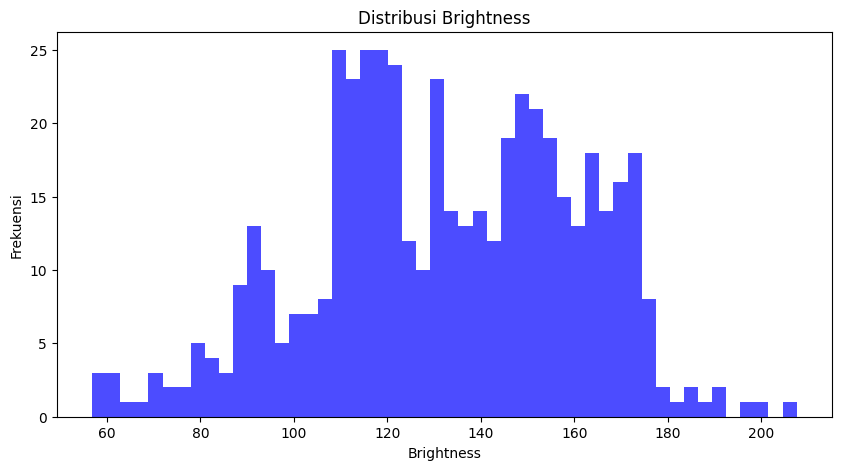

In [12]:
plt.figure(figsize=(10, 5))
plt.hist(brightness, bins=50, color='blue', alpha=0.7)
plt.title("Distribusi Brightness")
plt.xlabel("Brightness")
plt.ylabel("Frekuensi")
plt.show()

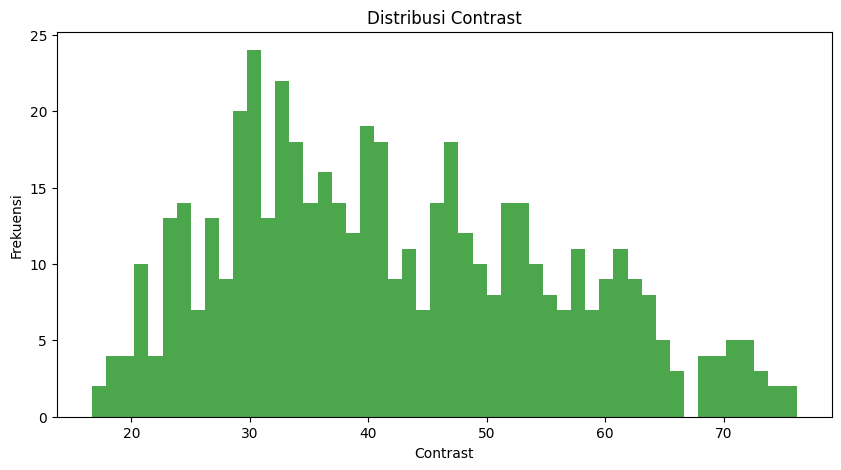

In [13]:
plt.figure(figsize=(10, 5))
plt.hist(contrast, bins=50, color='green', alpha=0.7)
plt.title("Distribusi Contrast")
plt.xlabel("Contrast")
plt.ylabel("Frekuensi")
plt.show()

## Data Preparation

### Data Augmentation

In [14]:
def rotate_image(image, angle):
    height, width = image.shape[:2]
    angle_rad = np.deg2rad(angle)
    midRow, midCol = height / 2, width / 2
    
    imgRotate = np.zeros_like(image)

    for i in range(height):
        for j in range(width):
            y = int((i - midRow) * np.cos(angle_rad) - (j - midCol) * np.sin(angle_rad) + midRow)
            x = int((i - midRow) * np.sin(angle_rad) + (j - midCol) * np.cos(angle_rad) + midCol)

            if 0 <= x < width and 0 <= y < height:
                imgRotate[i, j] = image[y, x]

    return imgRotate

In [15]:
# def translate_image(image, tx, ty):
#     height, width = image.shape[:2]
#     img_translated = np.zeros_like(image)
    
#     for i in range(height):
#         for j in range(width):
#             if 0 <= i + tx < height and 0 <= j + ty < width:
#                 img_translated[i + tx, j + ty] = image[i, j]
    
#     return img_translated

def mirror_image(image):
    height, width = image.shape[:2]
    mirrored_image = np.zeros_like(image)
    for y in range(height):
        for x in range(width):
            mirrored_image[y, x] = image[y, width - x - 1]
    return mirrored_image

In [16]:
rotated_images = [rotate_image(img, angle=180) for img in DataGambar]

mirror_images = [mirror_image(img) for img in rotated_images]

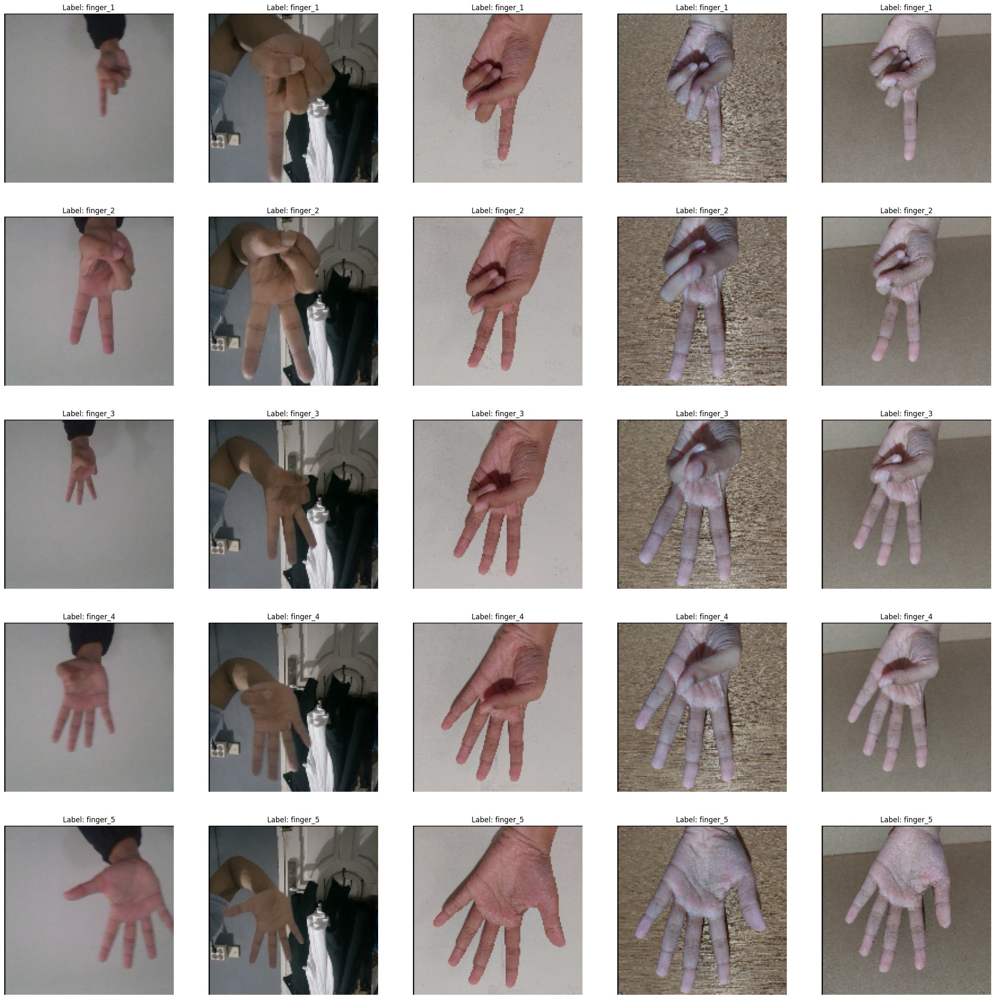

In [17]:
plot_sample_images(rotated_images, labelGambar, label_names, samples_per_label=5)

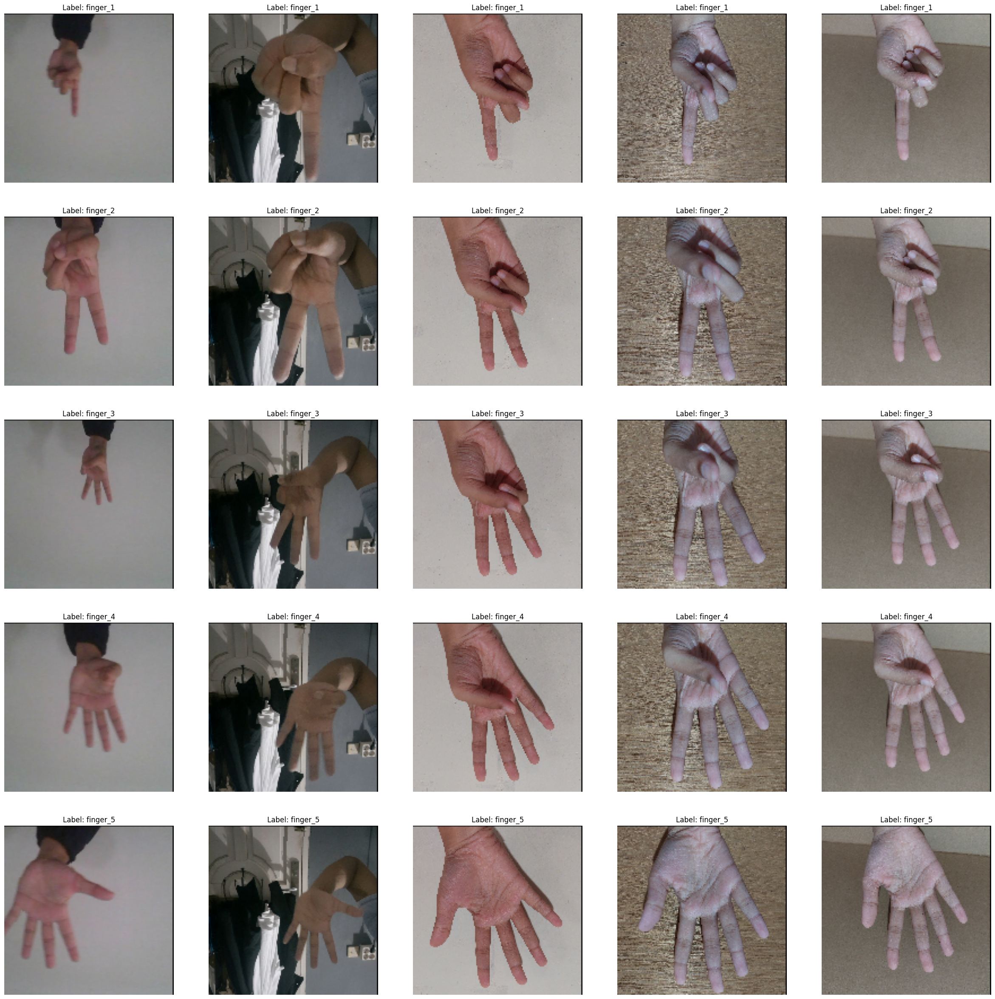

In [18]:
plot_sample_images(mirror_images, labelGambar, label_names, samples_per_label=5)

### Preprocessing

#### Preprocessing 1

In [19]:
def to_grayscale(image):
    return cv.cvtColor(image, cv.COLOR_BGR2GRAY)

In [20]:
def normalisasi(image, skala_min=0, skala_max=255):
    tinggi, lebar = image.shape
    hasil = np.zeros((tinggi, lebar))
    min_val = np.min(image)
    max_val = np.max(image)
    for i in range(tinggi):
        for j in range(lebar):
            hasil[i, j] = (image[i, j] - min_val) * (skala_max - skala_min) / (max_val - min_val) + skala_min
    return hasil

In [21]:
def intensity(image):
    image2 = normalisasi(image)
    arrHist = np.zeros(256)
    for i in range(image2.shape[0]):
        for j in range(image2.shape[1]):
            arrHist[int(image2[i, j])] += 1
    return arrHist

In [22]:
def probability(image):
    histnorm = intensity(image)
    prob = np.zeros(256, dtype=float)
    for i in range(len(histnorm)):
        prob[i] = histnorm[i] / sum(histnorm)
    return prob

In [23]:
def dist_kumulatif(image):
    prob = probability(image)
    grayscale = np.zeros((256), dtype=float)
    for i in range(len(grayscale)):
        if i == 0:
            grayscale[i] = prob[i]
        else:
            grayscale[i] = grayscale[i - 1] + prob[i]
    return grayscale

In [24]:
def pembulatan(x):
    x2 = int(x) + 1 / 2
    if x == int(x):
        return int(x)
    elif x < x2:
        return int(x)
    elif x >= x2:
        return int(x) + 1

In [25]:
def normal(image):
    grayscale = dist_kumulatif(image)
    norm = np.zeros((256), dtype=int)
    for i in range(len(norm)):
        norm[i] = pembulatan(grayscale[i] * 255)
    return norm

In [26]:
def mapping(normal, image):
    hasil = np.zeros((image.shape[0], image.shape[1]), dtype=int)
    for i in range(hasil.shape[0]):
        for j in range(hasil.shape[1]):
            index = int(round(image[i, j]))
            hasil[i, j] = normal[index]
    return hasil

In [27]:
def to_uint8(image):
    return np.clip(image, 0, 255).astype(np.uint8)

In [28]:
def plot_sample_imagesGray(images, labels, label_names, title="", samples_per_label=10, color_mode='rgb'):
    plt.figure(figsize=(30, 30))
    for i, label in enumerate(label_names):
        label_images = [img for img, lbl in zip(images, labels) if lbl == label]
        for j in range(samples_per_label):
            plt.subplot(len(label_names), samples_per_label, i * samples_per_label + j + 1)
            if color_mode == 'gray':
                plt.imshow(label_images[j], cmap='gray')
            else:
                plt.imshow(cv.cvtColor(label_images[j], cv.COLOR_BGR2RGB))
            plt.title(f"Label: {label}")
            plt.axis('off')
    plt.suptitle(title)
    plt.show()

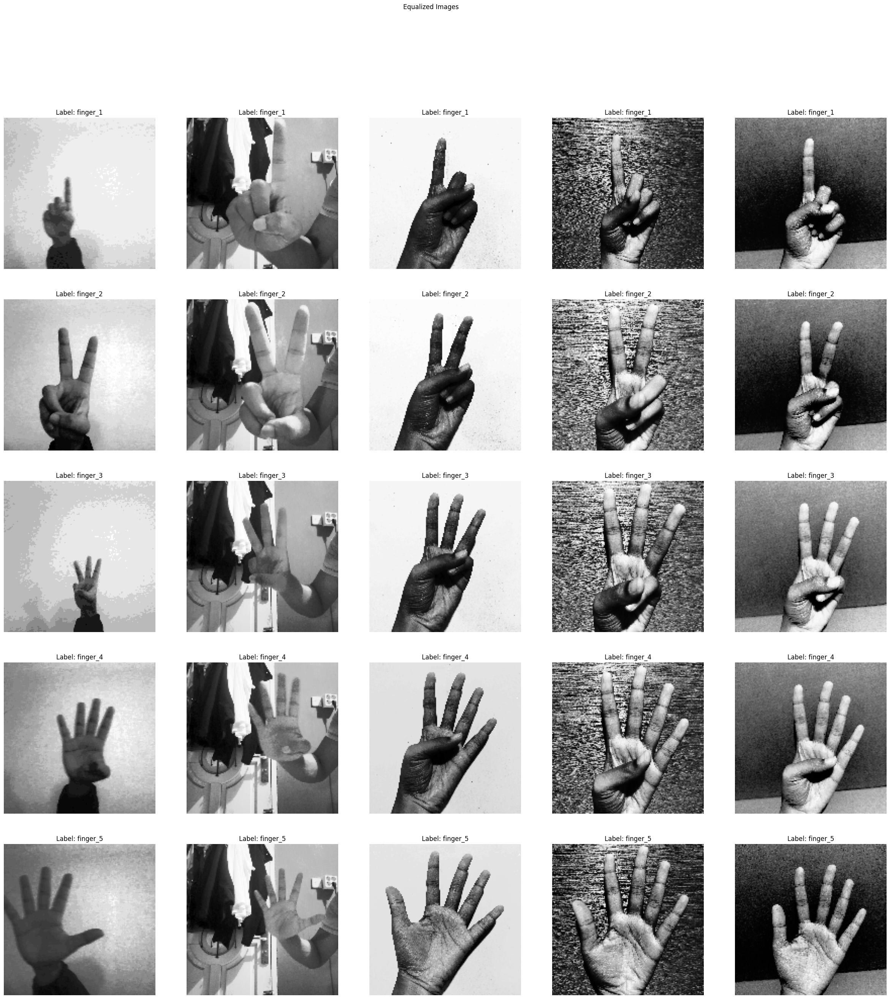

In [29]:
equalized_images = [to_uint8(mapping(normal(to_grayscale(image)), to_grayscale(image))) for image in DataGambar]
plot_sample_imagesGray(equalized_images, labelGambar, label_names, samples_per_label=5, title="Equalized Images", color_mode='gray')

#### Preprocessing 2

In [30]:
lpf = np.array ([0.5, 0.6])
hpf = np.array ([-0.7,0.7])

In [31]:
def konvolusiBaris(gambar, kernel):
    padding = np.pad(gambar,((0,0),(0,1)), 'constant', constant_values=0)
    hasil = np.zeros(gambar.shape).astype(np.float32)

    for i in range(gambar.shape[0]):
        for j in range(gambar.shape[1]- len(kernel)+1):
            for x in range(len(kernel)):
                hasil[i,j] += padding[i, j+x]*kernel[x]

    return hasil

def konvolusiKolom(gambar, kernel):
    padding = np.pad(gambar,((0,1),(0,0)), 'constant', constant_values=0)
    hasil = np.zeros(gambar.shape).astype(np.float32)

    for i in range(gambar.shape[0] - len(kernel)+1):
        sum=0
        for j in range(gambar.shape[1]):
            for x in range(len(kernel)):
                hasil[i,j] += padding[i+x, j]*kernel[x]

    return hasil

In [32]:
def downsamplingBaris(gambar):
    hasil = np.zeros((gambar.shape[0]//2, gambar.shape[1])).astype(np.float32)

    for i in range(gambar.shape[0]//2):
        # x=0
        for j in range(gambar.shape[1]):
            hasil[i,j] = gambar[2*i, j]        #[x][j]
        # x+=2
    return hasil

In [33]:
def downsamplingKolom(gambar):
    hasil = np.zeros((gambar.shape[0], gambar.shape[1]//2)).astype(np.float32)

    for i in range(gambar.shape[0]):
        # x=0
        for j in range(gambar.shape[1]//2):
            hasil[i,j] = gambar[i, 2*j]     #[i][x]
        # x+=2
    return hasil

In [34]:
def dekomposisi(gambar, level):
    konvolusiBarisLow = konvolusiBaris(gambar, lpf)
    konvolusiBarisHigh = konvolusiBaris(gambar, hpf)

    ds_kolLow = downsamplingKolom(konvolusiBarisLow)
    konvolusiKolomLow = konvolusiKolom(ds_kolLow, lpf)
    aproximate = downsamplingBaris(konvolusiKolomLow)

    konvolusiKolomHigh = konvolusiKolom(ds_kolLow, hpf)
    horizontal = downsamplingBaris(konvolusiKolomHigh)

    ds_kolHigh = downsamplingKolom(konvolusiBarisHigh)
    konvolusiKolomLow = konvolusiKolom(ds_kolHigh, lpf)
    vertikal = downsamplingBaris(konvolusiKolomLow)

    konvolusiKolomHigh = konvolusiKolom(ds_kolHigh, hpf)
    diagonal = downsamplingBaris(konvolusiKolomHigh)
    
    hasil = np.vstack((np.hstack((aproximate, horizontal)), np.hstack((vertikal, diagonal))))
    hasil_norm = (hasil - np.min(hasil)) / (np.max(hasil) - np.min(hasil))*255

    if level> 1:
        aproximate, horizontal, vertikal, diagonal, hasil_norm = dekomposisi(aproximate, level-1)
        return aproximate, horizontal, vertikal, diagonal, hasil_norm
    else:
        return aproximate, horizontal, vertikal, diagonal, hasil_norm

In [35]:
def plot_decomposed_samples(decomposed_images, labels, label_names, samples_per_label=5):
    for label in label_names:
        label_images = [img for img, lbl in zip(decomposed_images, labels) if lbl == label]
        for i in range(min(samples_per_label, len(label_images))):
            aproximate, horizontal, vertikal, diagonal, _ = label_images[i]
            fig, ax = plt.subplots(nrows=1, ncols=4, figsize=(20, 10))
            ax[0].imshow(aproximate, cmap='gray')
            ax[0].set_title(f'{label} - Aproximate')
            ax[1].imshow(horizontal, cmap='gray')
            ax[1].set_title(f'{label} - Detail Horizontal')
            ax[2].imshow(vertikal, cmap='gray')
            ax[2].set_title(f'{label} - Detail Vertikal')
            ax[3].imshow(diagonal, cmap='gray')
            ax[3].set_title(f'{label} - Detail Diagonal')
            
            for a in ax:
                a.axis('off')
                
            plt.show()

In [36]:
decomposed_images = [dekomposisi(to_grayscale(image), 1) for image in DataGambar]

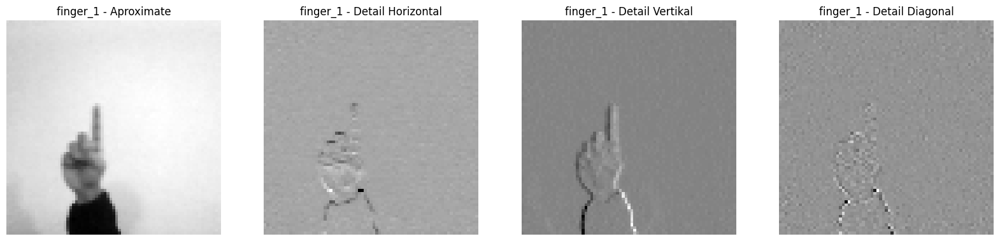

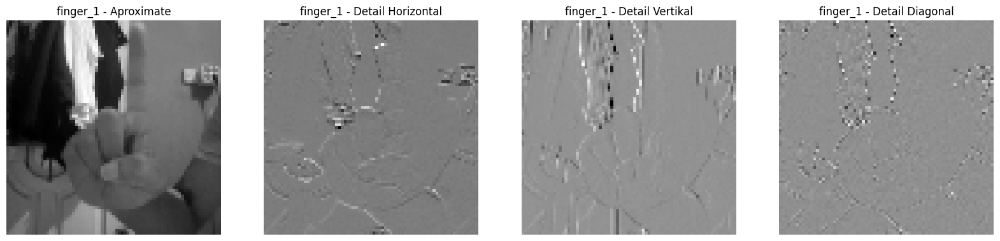

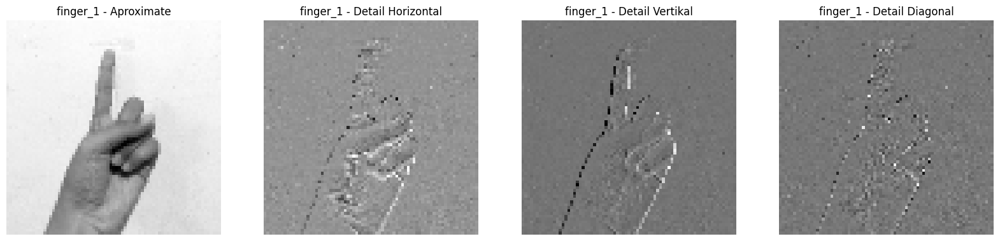

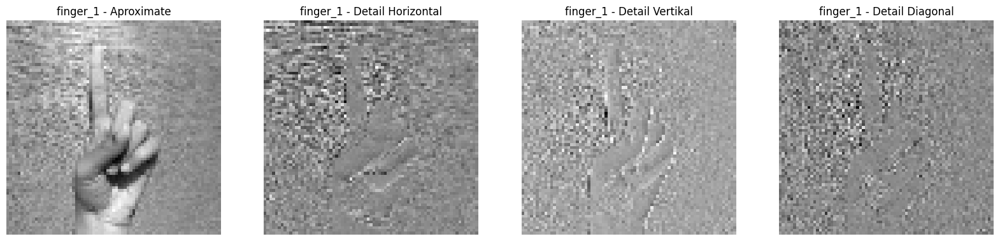

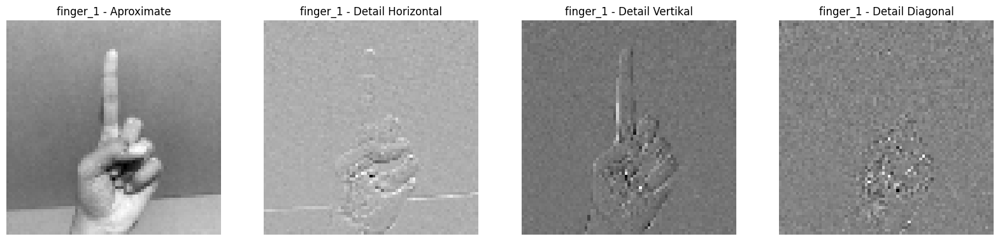

...

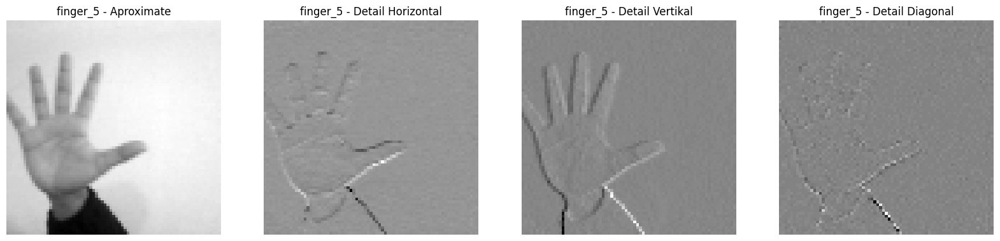

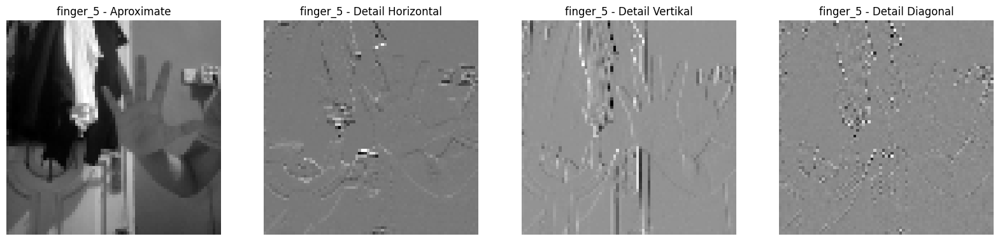

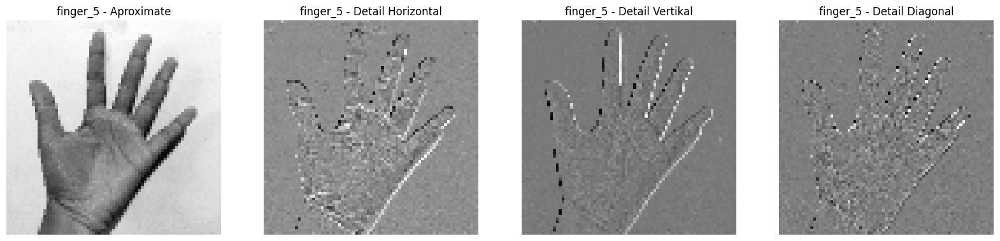

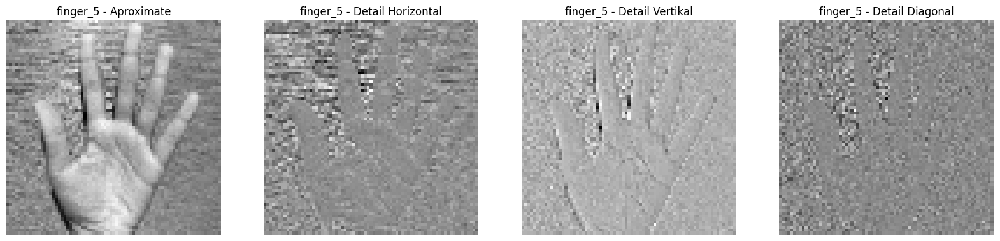

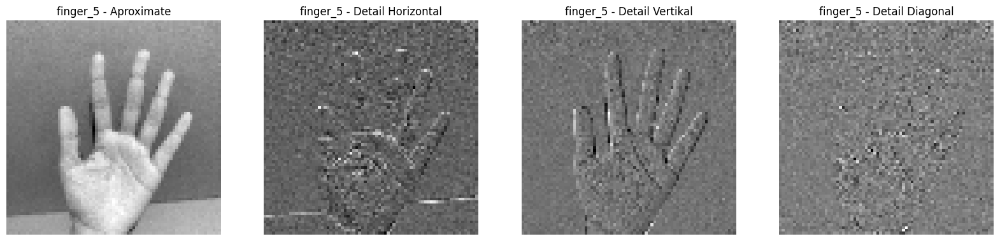

In [37]:
plot_decomposed_samples(decomposed_images, labelGambar, label_names, samples_per_label=5)

#### Preprocessing 3

In [38]:
def padding(gambar, kernel):
    if len(kernel)%2 == 0:
        n = int(len(kernel)/2)
        hasil = np.pad(gambar, ([0,n], [0,n]))
    else:
        n = int((len(kernel)-1)/2)
        hasil = np.pad(gambar, ([n,n], [n,n]))
    return hasil

In [39]:
def konvolusi(pad, gambar, kernel):
    hasil = np.zeros(gambar.shape).astype(int)
    for i in range(gambar.shape[0]):
        for j in range(gambar.shape[1]):

            for k in range(len(kernel)):
                for l in range(len(kernel)):
                    hasil[i,j] += pad[i+k, j+l] * kernel[k][l]
    return hasil

In [40]:
def deteksi_tepi(gambar, kernel1, kernel2):
    paddingGambar = padding(gambar, kernel1)

    konv1 = konvolusi(paddingGambar, gambar, kernel1)
    konv2 = konvolusi(paddingGambar, gambar, kernel2)

    square1 = konv1 * konv1
    square2 = konv2 * konv2

    Gradient_Y = np.zeros(square1.shape).astype(int)
    Gradient_Y = np.sqrt(square1)
    
    Gradient_X = np.zeros(square2.shape).astype(int)
    Gradient_X = np.sqrt(square2)

    jumlah = square1 + square2
    hasil = np.sqrt(jumlah)


    return hasil, Gradient_X, Gradient_Y



In [41]:
# kernel sobel
Sx = [[-1, 0, 1],
      [-2, 0, 2],
      [-1, 0, 1]]
Sy = [[ 1, 2, 1],
      [ 0, 0, 0],
      [-1,-2,-1]]

In [42]:
def plot_edge_detection_results(original_images, edges_images, label_names, samples_per_label=5):
    for i, label in enumerate(label_names):
        label_original_images = [img for img, lbl in zip(original_images, labelGambar) if lbl == label]
        label_edges_images = [img for img, lbl in zip(edges_images, labelGambar) if lbl == label]

        for j in range(min(samples_per_label, len(label_original_images))):
            fig, ax = plt.subplots(nrows=1, ncols=4, figsize=(20, 5))
            ax[0].imshow(label_original_images[j], cmap='gray')
            ax[0].set_title(f'{label} - Gambar Asli')
            ax[0].axis('off')

            ax[1].imshow(label_edges_images[j][1], cmap='gray')
            ax[1].set_title(f'{label} - Sobel Gradient X')
            ax[1].axis('off')

            ax[2].imshow(label_edges_images[j][2], cmap='gray')
            ax[2].set_title(f'{label} - Sobel Gradient Y')
            ax[2].axis('off')

            ax[3].imshow(label_edges_images[j][0], cmap='gray')
            ax[3].set_title(f'{label} - Hasil Sobel')
            ax[3].axis('off')

            plt.show()


In [43]:
gray_images = [to_grayscale(image) for image in DataGambar]

In [44]:
edges_images = [deteksi_tepi(gray_image, Sx, Sy) for gray_image in gray_images]

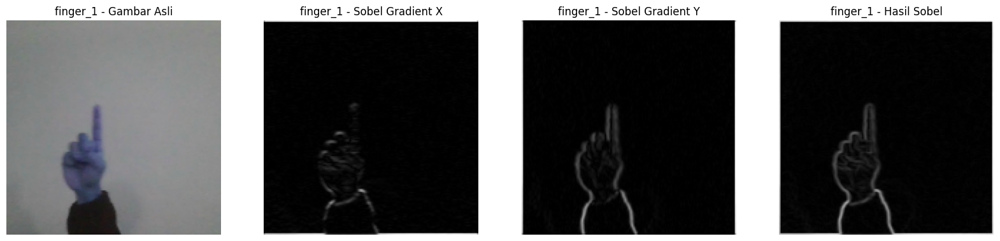

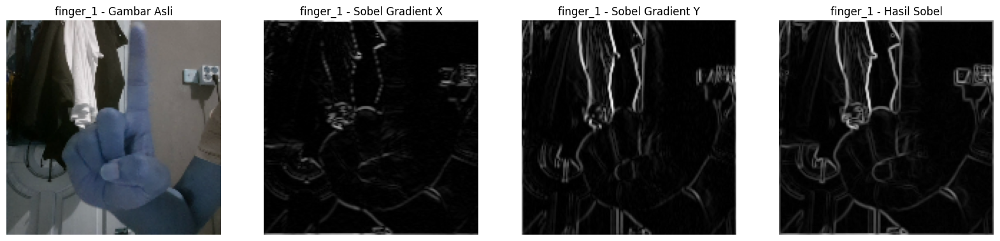

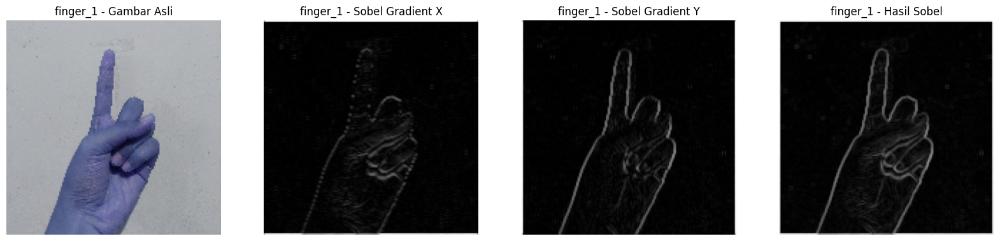

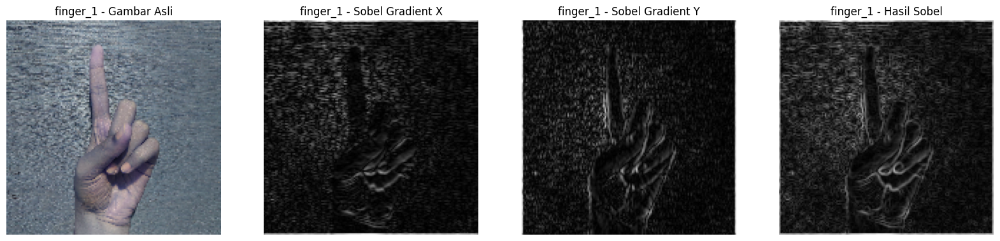

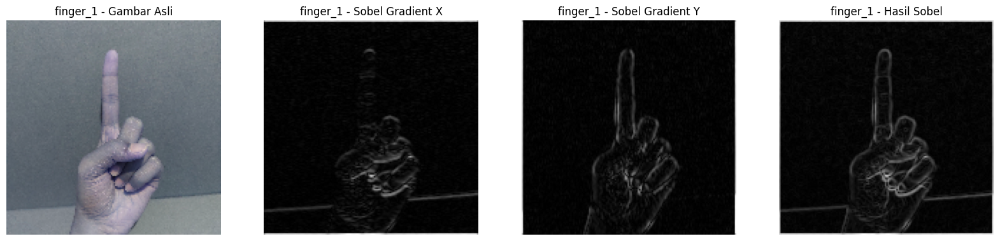

...

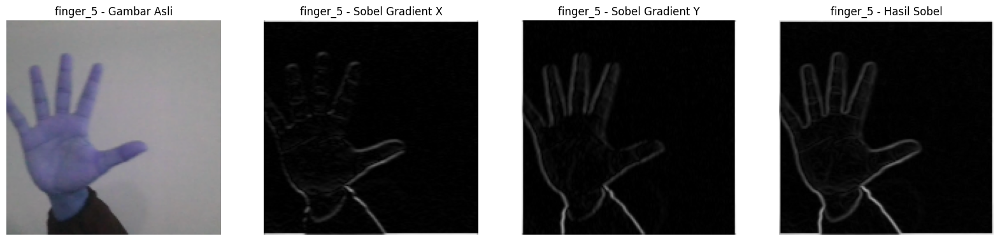

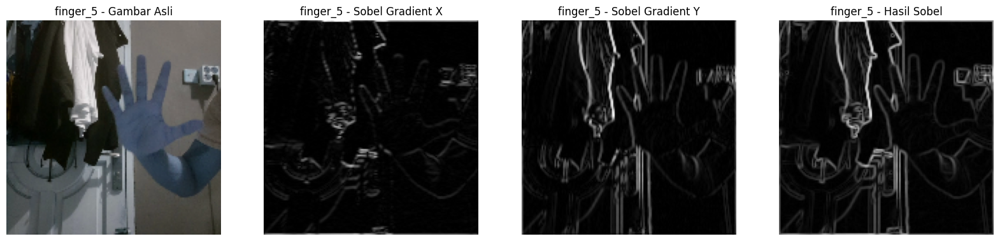

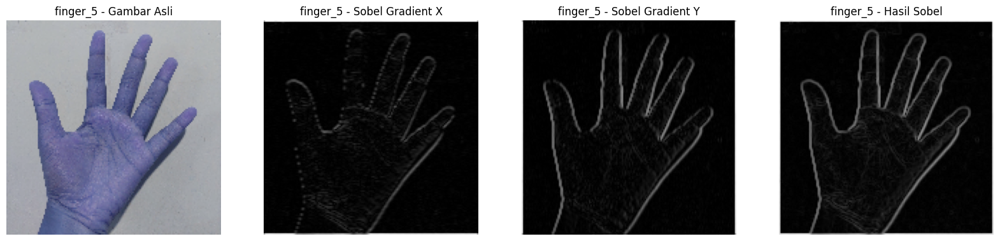

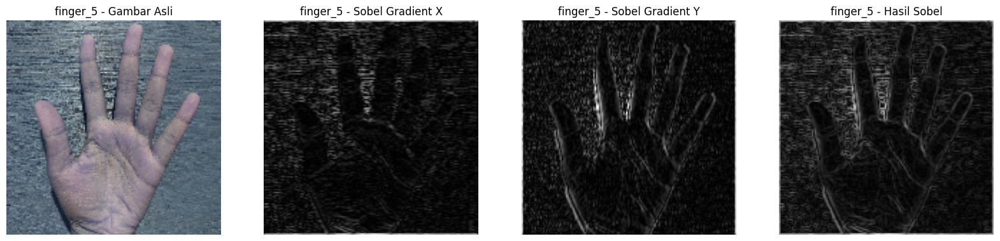

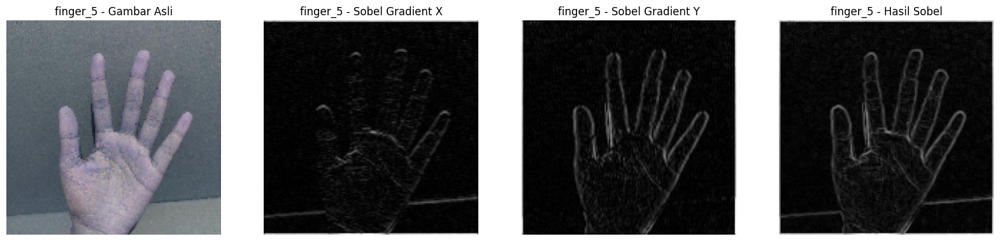

In [45]:
plot_edge_detection_results(DataGambar, edges_images, label_names, samples_per_label=5)

#### Preprocessing n

### Feature Extraction

In [46]:
# coba

### Features Selection

### Splitting Data

### Normalization

## Modeling

## Evaluation